# 2. Via 2.0 Cartography on Zebrahub (Trajectory Inference)
This tutorial focuses on how to perform TI analysis of Zebrahub. See Tutorial #3 for Atlas View creation

In [1]:
import scanpy as sc
import matplotlib.pyplot as plt
import numpy as np
import core_working_rw2 as via
from datetime import datetime


### Load the data
Data has been filtered and library normalized. Data is annotated with time/stage, cluster labels, and cell type labels (coarse and fine)

In [2]:
print(f'{datetime.now()}\tStart reading data')
adata=sc.read_h5ad( filename='/home/user/Trajectory/Datasets/Zebrafish_Lange2023/Rawdata/Zebrahub_data_via.h5ad')
#compute PCA
adata.uns['log1p']['base'] = None #fix for small bug in scanpy #see https://github.com/theislab/single-cell-tutorial/issues/97
sc.pp.highly_variable_genes(adata, n_top_genes=2000)
sc.tl.pca(adata, n_comps=100)
print(adata)

#load the adata_velo below if you want to try to use velocity. this is a 8GB file so is very RAM intensive
adata_velo = sc.read_h5ad('/home/user/Trajectory/Datasets/Zebrafish_Lange2023/Rawdata/Zebrahub_data_velocity_via.h5ad') #10GB file. if you dont have the RAM to load this, then you can still run Via2 without velocity.
print('adata_velo')
print(adata_velo)


2023-09-25 08:25:15.560669	Start reading data
AnnData object with n_obs × n_vars = 119457 × 28187
    obs: 'n_genes', 'n_counts', 'fish', 'timepoint_cluster', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_nc', 'pct_counts_nc', 'developmental_stage', 'timepoint', 'zebrafish_anatomy_ontology_class', 'zebrafish_anatomy_ontology_id', 'parc', 'kmeans50', 'celltype_extrainfo', 'zebrafish_anatomy_ontology_class_shobi', 'adjusted_timepoint', 'bool_list', 'global annotation', 'time_coarse_cell_type', 'time_fine_cell_type', 'parc_cluster', 'parc_cluster_and_cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'nc', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'global_annotation_colors', 'hvg', 'log1p', 'pca', 'timepoint_colors', 'zebrafish_anatomy_ontology_class_colors', 'zebrafish_anatomy_ontology_id_colors'
    obsm: 'X_U', 'X_Vi

### Extract some annotation

In [3]:
n_cells = adata.shape[0]
print('cells is', n_cells)
parc_cluster = [i for i in adata.obs['parc_cluster']]
parc_cluster_and_cell_type = [i for i in adata.obs['parc_cluster_and_cell_type']]
coarse_cell_type = [i for i in adata.obs['zebrafish_anatomy_ontology_class']]
fine_cell_type = [i for i in adata.obs['zebrafish_anatomy_ontology_class_shobi']] #consolidated annotaions from individual time point files
coarse_fine_cell_type = [coarse_cell_type[i] + fine_cell_type[i] for i in range(n_cells)]
time_point_numeric = [i for i in adata.obs['adjusted_timepoint']] #assigned a numeric value to each stage (e.g. 5hpf is 5, 10hpf is 10,...)
early_cell_type = [i if str(i) != 'nan' else '' for i in adata.obs['global annotation']]

hybrid_cell_time = [str(fine_cell_type[i]) + '_'+early_cell_type[i]+'_'+str(time_point_numeric[i]) for i in range(n_cells)] #labels of early stage cells which was provided for cells <24hpf also included
parc_numeric_cluster_labels = [i for i in adata.obs['parc']]
parc_cluster = [i for i in adata.obs['parc_cluster']]

cells is 119457


### Find a suitable root

In [4]:
root_str = 'paraxial mesoderm_Somites_0'
loc_root = np.where(np.asarray(hybrid_cell_time) == root_str)[0] #'paraxial mesoderm_PSM_0' 1 cell , 'paraxial mesoderm_Somites_0' has 51 cells, 'paraxial mesoderm_Muscle_0', 'tail bud_NMPs_0'
root = [loc_root[0]]
n_pcs = 100
print(f'{datetime.now()}\troot is cell number  {root[0]} of type {fine_cell_type[root[0]]}')

2023-09-25 08:28:03.566017	root is cell number  2604 of type paraxial mesoderm


### Initialize parameters

In [5]:
knn=30
time_series = True  
memory = 50
jac_std_global = 1  
random_seed = 0#1  
knn_sequential = 5  
t_diff_step = 2
do_gaussian_kernel_edgeweights = False
edgebundle_pruning_twice = True
cluster_graph_pruning_std = 0.15  
edgebundle_pruning = 0.05  
neighboring_terminal_states_threshold = 4 
viagraph_decay = 0.7
max_vis_out = 2
use_velocity = True
velo_weight = 0.5

if use_velocity:
    gene_matrix =np.asmatrix(adata_velo.layers['Ms'])
    velocity_matrix = np.asmatrix(adata_velo.layers['velocity'])
    velo_weight=velo_weight
else: 
    gene_matrix =None
    velocity_matrix = None
    velo_weight=0

### Set terminal states (optional)

In [6]:
# The parameter "user_defined_terminal_group" is being set to a list of group level annotations corresponding to the provided true_label. These were terminal fates detected in previous runs and saved for reproducability.
# This parameter can also be left to its default user_defined_terminal_group = []. the results should be similar.
user_defined_cellfates= ['0_cartilage element', '2_dermis', '49_fin',
                                          '67_pharyngeal arch', '120_cranial cartilage',
                                          '1_forebrain', '71_neuron', '89_diencephalon',
                                          '136_radial glial cell',
                                          '10_epidermal cell', '83_neuromast', 
                                          '145_enteric musculature', '55_myotome', 
                                          '46_hematopoietic cell',   '102_vasculature', '127_Muller cell', '105_oligodendrocyte',   '69_liver', '90_pharynx',
                                          '95_intestine']

### Initialize and Run the Via2.0 Class

In [7]:
# Initialize and Run the Via2.0 Class
print(f'{datetime.now()}\tRun Via2.0')

v0 = via.VIA(adata.obsm['X_pca'][:, 0:n_pcs], true_label=parc_cluster_and_cell_type, jac_std_global=jac_std_global,
             labels=parc_cluster,
             dist_std_local=1, knn=knn, memory=memory,
             user_defined_terminal_group=user_defined_cellfates,
             cluster_graph_pruning_std=cluster_graph_pruning_std,
             neighboring_terminal_states_threshold=neighboring_terminal_states_threshold,
             too_big_factor=0.3, resolution_parameter=1,
             root_user=root, dataset='', random_seed=random_seed,
             is_coarse=True, preserve_disconnected=False, pseudotime_threshold_TS=40, x_lazy=0.99,
             do_gaussian_kernel_edgeweights=do_gaussian_kernel_edgeweights,
             alpha_teleport=0.99, edgebundle_pruning=edgebundle_pruning, edgebundle_pruning_twice=True,
             time_series=time_series, time_series_labels=time_point_numeric, knn_sequential=knn_sequential,
             knn_sequential_reverse=knn_sequential, t_diff_step=t_diff_step, velo_weight=velo_weight, velocity_matrix=velocity_matrix, gene_matrix=gene_matrix,
             do_compute_embedding=False)

v0.run_VIA()
v0.embedding = adata.obsm['X_Via2_Atlas']


2023-09-25 08:28:03.589451	Run Via2.0
2023-09-25 08:28:04.804497	Running VIA over input data of 119457 (samples) x 100 (features)
2023-09-25 08:28:04.804574	Knngraph has 30 neighbors
2023-09-25 08:28:42.727156	Using time series information to guide knn graph construction 
2023-09-25 08:28:42.736297	Time series ordered set [0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
2023-09-25 08:29:35.321478	Shape neighbors (119457, 30) and sequential neighbors (119457, 10)
2023-09-25 08:29:35.354718	Shape augmented neighbors (119457, 40)
2023-09-25 08:29:35.380011	Actual average allowable time difference between nodes is 10.0
2023-09-25 08:30:02.089539	Finished global pruning of 30-knn graph used for clustering at level of 1. Kept 87.6 % of edges. 
2023-09-25 08:30:02.213207	Number of connected components used for clustergraph  is 1
2023-09-25 08:30:18.393414	Using predfined labels provided by user (this must be provided as an array)
2023-09-25 08:30:18.393502	Making cluster graph. Global cluster graph pru

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/scipy/sparse/_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


2023-09-25 08:30:23.954500	Looking for initial states
2023-09-25 08:30:24.106221	Stationary distribution normed [0.01  0.005 0.009 0.032 0.015 0.01  0.006 0.006 0.008 0.022 0.008 0.009
 0.012 0.007 0.009 0.011 0.006 0.021 0.001 0.002 0.008 0.004 0.003 0.009
 0.006 0.014 0.006 0.016 0.011 0.001 0.003 0.008 0.003 0.007 0.007 0.004
 0.006 0.001 0.007 0.002 0.005 0.012 0.009 0.005 0.007 0.018 0.    0.005
 0.011 0.006 0.007 0.008 0.017 0.006 0.017 0.004 0.005 0.003 0.01  0.005
 0.012 0.007 0.015 0.002 0.007 0.005 0.006 0.005 0.018 0.005 0.011 0.006
 0.    0.008 0.006 0.006 0.005 0.004 0.003 0.007 0.006 0.008 0.001 0.002
 0.011 0.008 0.001 0.005 0.002 0.003 0.005 0.001 0.006 0.003 0.002 0.006
 0.006 0.019 0.008 0.007 0.003 0.012 0.001 0.004 0.009 0.001 0.001 0.002
 0.012 0.008 0.007 0.011 0.003 0.008 0.005 0.001 0.004 0.006 0.011 0.002
 0.005 0.005 0.021 0.009 0.006 0.002 0.005 0.001 0.001 0.002 0.005 0.002
 0.008 0.015 0.    0.017 0.006 0.005 0.005 0.004 0.001 0.004 0.006 0.005
 0.003 0.005

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
do scaling of pt
2023-09-25 08:30:41.521269	Terminal cluster list based on user defined cells/groups: [('0_cartilage element', 0), ('2_dermis', 2), ('49_fin', 49), ('67_pharyngeal arch', 67), ('120_cranial cartilage', 120), ('1_forebrain', 1), ('71_neuron', 71), ('89_diencephalon', 89), ('136_radial glial cell', 136), ('10_epidermal cell', 10), ('83_neuromast', 83), ('145_enteric musculature', 145), ('55_myotome', 55), ('46_hematopoietic cell', 46), ('102_vasculature', 102), ('127_Muller cell', 127), ('105_oligodendrocyte', 105), ('69_liver', 69), ('90_pharynx', 90), ('95_intestine', 95)]
2023-09-25 08:30:41.521658	Terminal clusters corresponding to unique lineages in this component are [0, 2, 49, 67, 120, 1, 71, 89, 136, 10, 83, 145, 55, 46, 102, 127, 105, 69, 90, 95] 
TESTING rw2_lineage probability at memory 50
testing rw2 lineage probability at memory 50
g.indptr.size, 147


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1000 [00:00<?, ?it/s]

2023-09-25 08:30:46.871385	 Cluster or terminal cell fate 0 is reached 194.0 times
2023-09-25 08:30:47.265164	 Cluster or terminal cell fate 2 is reached 211.0 times
2023-09-25 08:30:47.620006	 Cluster or terminal cell fate 49 is reached 38.0 times
2023-09-25 08:30:47.959715	 Cluster or terminal cell fate 67 is reached 206.0 times
2023-09-25 08:30:48.442676	 Cluster or terminal cell fate 120 is reached 52.0 times
2023-09-25 08:30:48.917698	 Cluster or terminal cell fate 1 is reached 265.0 times
2023-09-25 08:30:49.369804	 Cluster or terminal cell fate 71 is reached 148.0 times
2023-09-25 08:30:49.691185	 Cluster or terminal cell fate 89 is reached 485.0 times
2023-09-25 08:30:50.014253	 Cluster or terminal cell fate 136 is reached 137.0 times
2023-09-25 08:30:50.368288	 Cluster or terminal cell fate 10 is reached 29.0 times
2023-09-25 08:30:50.585364	 Cluster or terminal cell fate 83 is reached 128.0 times
2023-09-25 08:30:50.860216	 Cluster or terminal cell fate 145 is reached 37.0 ti

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/scipy/sparse/_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


2023-09-25 08:31:06.258257	Hammer dims: Nodes shape: (146, 2) Edges shape: (918, 3)
2023-09-25 08:31:06.490458	Time elapsed 151.8 seconds


### Visualise Via 2.0 Cluster Graph

2023-09-25 08:31:06.497122	 plotting piechart_graph


/home/user/PycharmProjects/Via2_May2023_py310/plotting_via.py:3242: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],
/home/user/PycharmProjects/Via2_May2023_py310/plotting_via.py:3242: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],
/home/user/PycharmProjects/Via2_May2023_py310/plotting_via.py:3242: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],


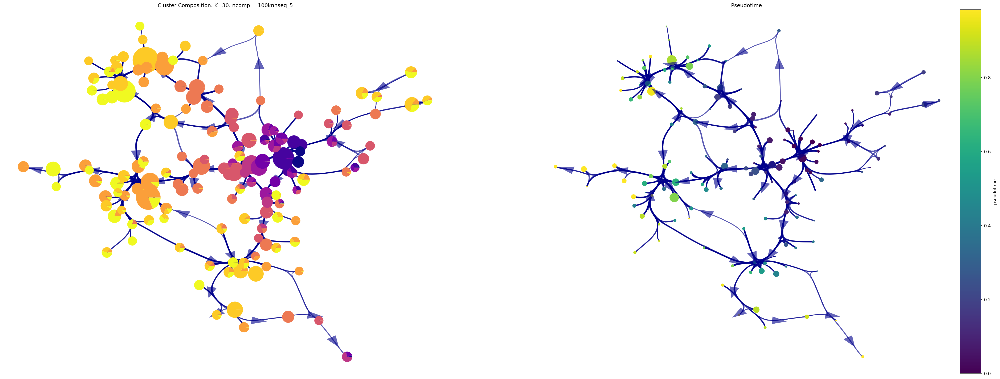

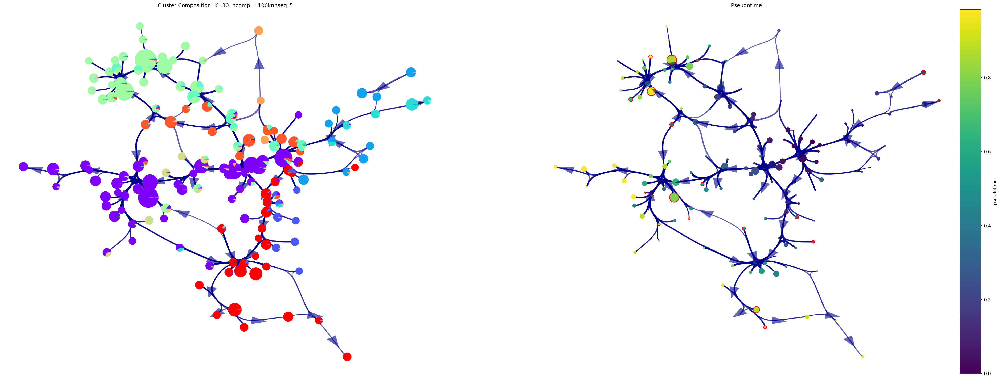

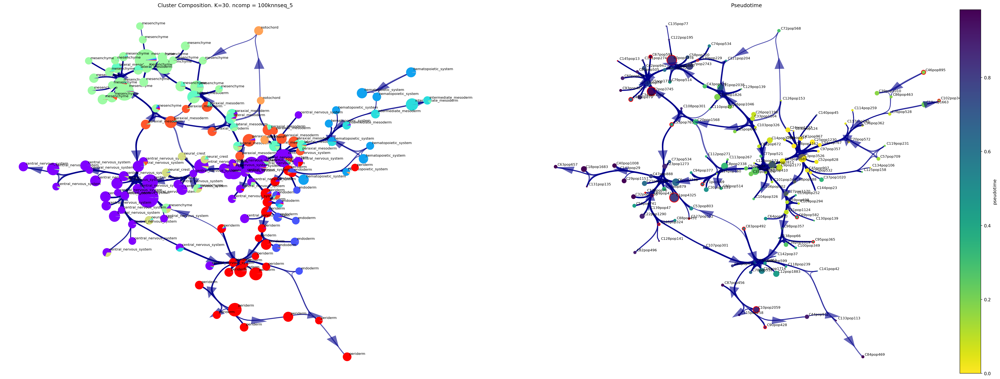

In [8]:
print(f'{datetime.now()}\t plotting piechart_graph')
fig,ax1, ax2 = via.draw_piechart_graph(via_object=v0, reference_labels=time_point_numeric, show_legend=False, ax_text=False,
                        headwidth_arrow=0.8, highlight_terminal_clusters=False, cmap_piechart='plasma', cmap='viridis',
                        pie_size_scale=0.6,size_node_notpiechart=1)
fig.set_size_inches(40, 15)
fig,ax1, ax2=via.draw_piechart_graph(via_object=v0, reference_labels=coarse_cell_type, show_legend=False, ax_text=False,
                        headwidth_arrow=0.8, highlight_terminal_clusters=True, cmap_piechart='rainbow',cmap='viridis',
                        pie_size_scale=0.5,size_node_notpiechart=1)
fig.set_size_inches(40, 15)

fig,ax1, ax2=via.draw_piechart_graph(via_object=v0, reference_labels=coarse_cell_type, show_legend=False, ax_text=True,
                        headwidth_arrow=0.8, highlight_terminal_clusters=True, cmap_piechart='rainbow', 
                        pie_size_scale=0.5,size_node_notpiechart=1)
fig.set_size_inches(40, 15)
plt.show()


### Plot single-cell lineage probabilities
***Memory***
- The lineage probability pathways below are computed based on a memory parameter value of 10 (set when we initialized Via), this is a high degree of memory. The drawback of too high memory can be that some populations are difficult to reach depending on the connectivity of the network. You can always try lowering the value to e.g. 10 or 50. 
- If you run Via at *memory=1* (the no memory case), and then plot the lineage probability pathways and gene trends, you will notice that many of the pathways are diffuse (migrating into unrelated cell populations) and the gene trends can overlap and not be very discriminative. 

2023-09-25 08:51:07.722086	Computing Edges
2023-09-25 08:51:07.722529	Start finding milestones


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


2023-09-25 08:51:42.084294	End milestones with 150
2023-09-25 08:51:42.987485	Recompute weights
2023-09-25 08:51:43.034686	pruning milestone graph based on recomputed weights
2023-09-25 08:51:43.036168	Graph has 1 connected components before pruning
2023-09-25 08:51:43.036927	Graph has 1 connected components after pruning
2023-09-25 08:51:43.037140	Graph has 1 connected components after reconnecting
2023-09-25 08:51:43.039276	regenerate igraph on pruned edges
2023-09-25 08:51:43.153458	Setting numeric label as time_series_labels or other sequential metadata for coloring edges
2023-09-25 08:51:43.447375	Making smooth edges
location of 0 is at [0] and 0
location of 49 is at [2] and 2
location of 67 is at [3] and 3
2023-09-25 08:52:26.579091	Computing Edges
2023-09-25 08:52:26.579166	Start finding milestones


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


2023-09-25 08:53:06.470646	End milestones with 150
2023-09-25 08:53:07.287766	Recompute weights
2023-09-25 08:53:07.332253	pruning milestone graph based on recomputed weights
2023-09-25 08:53:07.333929	Graph has 1 connected components before pruning
2023-09-25 08:53:07.334678	Graph has 1 connected components after pruning
2023-09-25 08:53:07.334900	Graph has 1 connected components after reconnecting
2023-09-25 08:53:07.336952	regenerate igraph on pruned edges
2023-09-25 08:53:07.414547	Setting numeric label as time_series_labels or other sequential metadata for coloring edges
2023-09-25 08:53:07.827237	Making smooth edges
location of 1 is at [5] and 5
location of 71 is at [6] and 6
location of 89 is at [7] and 7
2023-09-25 08:53:52.238403	Marker_lineages: [0, 49, 67]
2023-09-25 08:53:52.238497	Automatically setting embedding to via_object.embedding
2023-09-25 08:53:52.370089	The number of components in the original full graph is 1
2023-09-25 08:53:52.370135	For downstream visualization

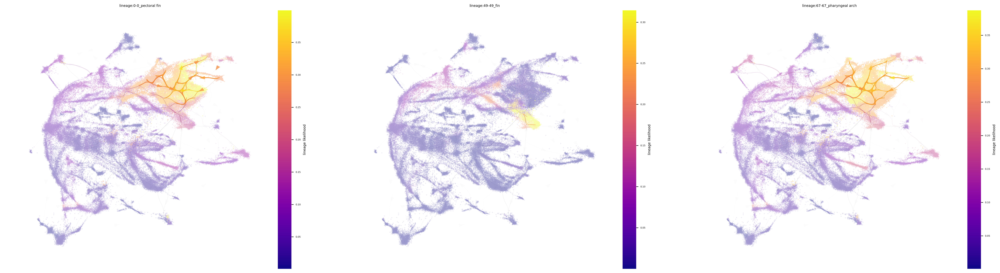

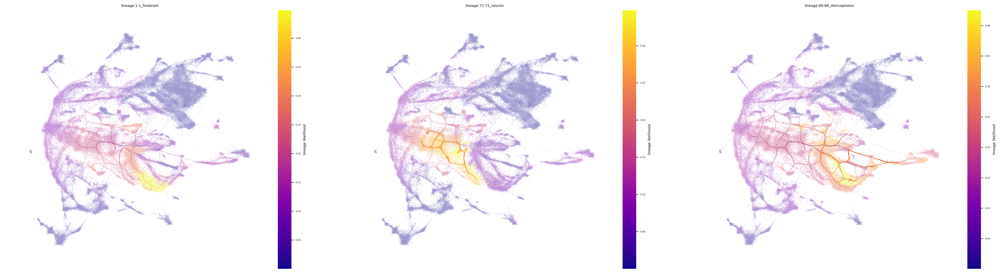

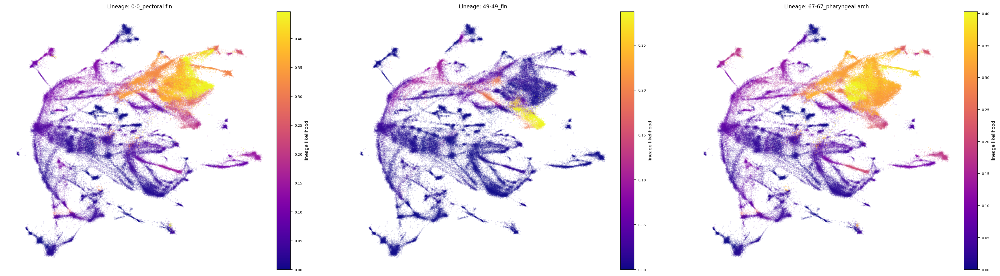

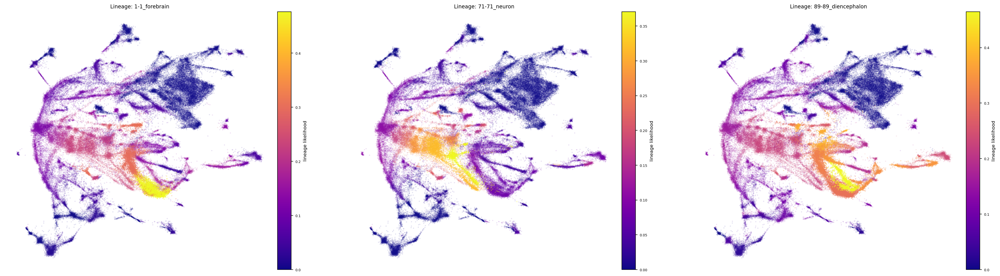

In [13]:
ecto_lineages=[1,71,89]#,136,10]#,83,115] #CNS
meso_lineages = [0,49,67]#,120,145]#,55,37,46,102]

fig, ax = via.plot_atlas_view(via_object=v0, lineage_pathway=meso_lineages,
                               linewidth_bundle=1, alpha_bundle_factor=2, headwidth_bundle=0.3,
                               size_scatter=0.1, alpha_scatter=0.5, use_sc_labels_sequential_for_direction=True)

fig.set_size_inches(30 , 8)

fig, ax = via.plot_atlas_view(via_object=v0, lineage_pathway=ecto_lineages,
                               linewidth_bundle=1, alpha_bundle_factor=2, headwidth_bundle=0.3,
                               size_scatter=0.1, alpha_scatter=0.5, use_sc_labels_sequential_for_direction=True)
fig.set_size_inches(30 , 8)
fig, ax = via.draw_sc_lineage_probability(via_object=v0, alpha_factor=0.6, scatter_size=4,
                                          marker_lineages=meso_lineages)
fig.set_size_inches(30 , 8)
fig, ax = via.draw_sc_lineage_probability(via_object=v0, alpha_factor=0.6, scatter_size=4,
                                          marker_lineages=ecto_lineages)
fig.set_size_inches(30 , 8)
plt.show()

### Differentiation Flow 

Generates a differentiation flow diagram based on the Via2.0 clustergraph. The second plot in each function call has the details by parc cluster and major cell population. In this case, we assign a different root node for each set of lineages.

2023-09-25 08:49:15.613940	Marker_lineages: [0, 49, 67, 120, 145, 55, 37, 46, 102]
automatically setting embedding to via_object.embedding
2023-09-25 08:49:15.614169	Start dictionary modes
2023-09-25 08:49:15.852553	End dictionary modes
2023-09-25 08:49:18.016249	Check sc pb 1.0 
2023-09-25 08:49:25.668206	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 0: [97, 25, 41, 24, 14, 65, 20, 110, 36, 26, 11, 58, 0]


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
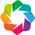

2023-09-25 08:49:25.741354	Holoviews for TC 0
dest 0, is at loc 0 on the bp_array
2023-09-25 08:49:25.741804	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 49: [97, 25, 41, 24, 14, 65, 20, 110, 36, 26, 43, 79, 137, 49]


2023-09-25 08:49:25.806408	Holoviews for TC 49
dest 49, is at loc 2 on the bp_array
2023-09-25 08:49:25.807038	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 67: [97, 25, 41, 24, 14, 65, 20, 110, 36, 26, 11, 58, 7, 67]


2023-09-25 08:49:25.840009	Holoviews for TC 67
dest 67, is at loc 3 on the bp_array
2023-09-25 08:49:25.840436	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 120: [97, 25, 41, 24, 14, 65, 20, 110, 36, 26, 11, 58, 0, 120]


2023-09-25 08:49:25.889504	Holoviews for TC 120
dest 120, is at loc 4 on the bp_array
2023-09-25 08:49:25.889883	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 145: [97, 25, 41, 24, 14, 65, 20, 110, 36, 26, 43, 79, 15, 145]


2023-09-25 08:49:25.941053	Holoviews for TC 145
dest 145, is at loc 11 on the bp_array
2023-09-25 08:49:25.941432	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 55: [97, 25, 41, 24, 14, 65, 20, 55]


2023-09-25 08:49:26.001078	Holoviews for TC 55
dest 55, is at loc 12 on the bp_array
2023-09-25 08:49:26.001825	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 37: [97, 54, 70, 57, 125, 37]


2023-09-25 08:49:26.052467	Holoviews for TC 37
2023-09-25 08:49:26.052785	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 46: [97, 54, 70, 117, 86, 46]


2023-09-25 08:49:26.113529	Holoviews for TC 46
dest 46, is at loc 13 on the bp_array
2023-09-25 08:49:26.114352	Cluster path on clustergraph starting from Root Cluster 97 to Terminal Cluster 102: [97, 54, 70, 96, 76, 102]


2023-09-25 08:49:26.179086	Holoviews for TC 102
dest 102, is at loc 14 on the bp_array
2023-09-25 08:49:26.182116	Start sankey
2023-09-25 08:49:26.272915	make sankey color dict
2023-09-25 08:49:26.274535	set options and render


2023-09-25 08:49:27.354921	Marker_lineages: [1, 22, 71, 89, 136, 10, 83, 115]
automatically setting embedding to via_object.embedding
2023-09-25 08:49:27.355000	Start dictionary modes
2023-09-25 08:49:27.545101	End dictionary modes
2023-09-25 08:49:29.465100	Check sc pb 1.0 
2023-09-25 08:49:35.972127	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 1: [52, 3, 17, 61, 113, 80, 53, 1]


2023-09-25 08:49:36.004311	Holoviews for TC 1
dest 1, is at loc 5 on the bp_array
2023-09-25 08:49:36.004850	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 22: [52, 3, 17, 9, 92, 50, 8, 23, 32, 22]


2023-09-25 08:49:36.043009	Holoviews for TC 22
2023-09-25 08:49:36.043484	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 71: [52, 3, 17, 61, 113, 80, 53, 1, 71]


2023-09-25 08:49:36.088468	Holoviews for TC 71
dest 71, is at loc 6 on the bp_array
2023-09-25 08:49:36.089030	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 89: [52, 3, 17, 9, 92, 50, 8, 23, 32, 89]


2023-09-25 08:49:36.139421	Holoviews for TC 89
dest 89, is at loc 7 on the bp_array
2023-09-25 08:49:36.139808	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 136: [52, 3, 17, 61, 113, 80, 53, 1, 6, 48, 136]


2023-09-25 08:49:36.198432	Holoviews for TC 136
dest 136, is at loc 8 on the bp_array
2023-09-25 08:49:36.198699	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 10: [52, 45, 68, 27, 59, 31, 109, 95, 141, 44, 90, 10]


2023-09-25 08:49:36.264525	Holoviews for TC 10
dest 10, is at loc 9 on the bp_array
2023-09-25 08:49:36.264947	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 83: [52, 45, 68, 27, 59, 31, 83]


2023-09-25 08:49:36.322102	Holoviews for TC 83
dest 83, is at loc 10 on the bp_array
2023-09-25 08:49:36.322475	Cluster path on clustergraph starting from Root Cluster 52 to Terminal Cluster 115: [52, 45, 68, 27, 98, 138, 142, 66, 78, 115]


2023-09-25 08:49:36.379335	Holoviews for TC 115
2023-09-25 08:49:36.381979	Start sankey
2023-09-25 08:49:36.459963	make sankey color dict
2023-09-25 08:49:36.462874	set options and render


In [12]:
ecto_lineages=[1,22,71,89,136,10,83,115] #CNS
meso_lineages = [0,49,67,120,145,55,37,46,102]
via.draw_differentiation_flow(via_object=v0, marker_lineages=meso_lineages, label_node=coarse_fine_cell_type,
                              do_log_flow=True, root_cluster_list=[97])  # cluster corresponding to root

via.draw_differentiation_flow(via_object=v0, marker_lineages=ecto_lineages, label_node=coarse_fine_cell_type,
                              do_log_flow=True, root_cluster_list=[52])  # cluster corresponding to a suitable CNS root
plt.show()